## Fraud Detection inotech

In [256]:
import pandas as pd 
import numpy as np
import math
from datetime import datetime
from sklearn.decomposition import IncrementalPCA
#Plotting
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter
import re
#Models 
from sklearn.naive_bayes import MultinomialNB
from sklearn.cluster import DBSCAN
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from sklearn.decomposition import IncrementalPCA
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
#clustering 
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
import pandas as pd 
import numpy as np 
import pandas as pd 
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
#Models
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn import tree
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import AdaBoostClassifier
# from xgboost import XGBClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.feature_selection import SelectFromModel
#metrics
from statistics import mean, stdev
import math
from sklearn.metrics import classification_report
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score
from sklearn.metrics import precision_score
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
#plotting packages
import matplotlib.pyplot as plt
from matplotlib import pyplot
from matplotlib.pyplot import figure
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import LearningRateScheduler
import tensorflow as tf
from sklearn.metrics import classification_report
from sklearn.metrics import precision_recall_curve
import numpy as np
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import BatchNormalization, Dense, Dropout, Input
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import StandardScaler
import dask.dataframe as dd
from sklearn.ensemble import IsolationForest
import statsmodels.api as sm
from statsmodels.tsa.seasonal import seasonal_decompose
from tensorflow.keras.utils import to_categorical
from sklearn.inspection import permutation_importance
#Warning
#Ignore warning
import warnings
warnings.filterwarnings("ignore")
#Ignore warning
import warnings
warnings.filterwarnings("ignore")

## Outline
- [Methods](#0)
- [Dataset](#1)
- [Features](#2)
- [Graph Based Features](#3)
- [Train the models](#4)


<a name="0"></a>
**Methods**

In [36]:
def featureAnalysis(feature,dataset):
    a = dataset.describe()
    b = a[feature].to_frame().T
    fig, ax = plt.subplots(2, 1, figsize=(20, 18))
    sns.histplot(x=dataset[feature], data=dataset, kde=True, element="step",ax=ax[0])
    sns.boxplot(data=dataset , x = feature ,ax=ax[1])
    return(b)

In [37]:
def confusionMat(Y_test, y_pred,y_prob,modelName):
    cf_matrix = confusion_matrix(Y_test, y_pred)
    group_names = ['True Neg','False Pos','False Neg','True Pos']
    group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    fpr, tpr, thresh = roc_curve(Y_test, y_prob, pos_label=1)
    auc = roc_auc_score(Y_test, y_prob)
    
    accuracy = accuracy_score(Y_test, y_pred)
    f1 = f1_score(Y_test, y_pred)

    print("\n",modelName,"...................................\n") 
    print("Accuracy:", accuracy)
    print("F1-Score:", f1)
    fig, ax = plt.subplots(1, 2, figsize=(20, 8))
    sns.heatmap(cf_matrix, annot=labels, fmt="", cmap='Blues',ax=ax[0])
    plt.plot(fpr,tpr,label="AUC="+str(auc))
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.legend(loc=4)
    plt.show()
    print(classification_report(Y_test, y_pred,zero_division=1))
    return accuracy, f1

In [38]:
def KmeansMethod(dataset,minK,maxK): 
    inertia = []
    silhouette_scores = []
    silhouette_dict = {}  # Dictionary to store silhouette scores
    k_values = range(minK, maxK)  # Test values of k from 2 to 10

    for k in k_values:
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(dataset)
        inertia.append(kmeans.inertia_)
        silhouette_score_k = silhouette_score(dataset, kmeans.labels_)
        silhouette_scores.append(silhouette_score_k)
        silhouette_dict[k] = silhouette_score_k
        
    sorted_scores = sorted(silhouette_dict.items(), key=lambda x: x[1], reverse=True)

    # Print all silhouette scores in sorted order
    print("Silhouette scores (sorted in descending order):")
    for k, score in sorted_scores:
        print(f"Silhouette score for k={k}: {score}")
        
    # Plotting inertia and silhouette score
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 2, 1)
    plt.plot(k_values, inertia, marker='o')
    plt.xlabel('Number of clusters (k)')
    plt.ylabel('Inertia')
    plt.title('Inertia vs. Number of Clusters')

    plt.subplot(1, 2, 2)
    plt.plot(k_values, silhouette_scores, marker='o')
    plt.xlabel('Number of clusters (k)')
    plt.ylabel('Silhouette Score')
    plt.title('Silhouette Score vs. Number of Clusters')

    plt.tight_layout()
    plt.show()

<a name="1"></a>
## Datasets

In [39]:
train = pd.read_csv("data/InnoTech-Data/Trainset-Evaluation/Train_Set.csv")
evaluation   = pd.read_csv("data/InnoTech-Data/Trainset-Evaluation/Evaluation_Set.csv")
transactions = pd.read_csv("data/InnoTech-Data/Transaction/InnoTech_Trans.csv")

**Train and evaluation**

In [40]:
train

,CARD,DATE,LABEL
0,009e24d27d670b24a73d,2023/05/09 00:00:00,1.0
1,009e24d27d670b24a73d,2023/05/03 00:00:00,1.0
2,009e24d27d670b24a73d,2023/04/26 00:00:00,1.0
3,034ae47f44e914cb7ee6,2023/05/30 00:00:00,1.0
4,0b2c8a4c5e9a0b1546ee,2023/03/16 00:00:00,1.0
...,...,...,...
28180,ad0b2864c4544f27c83d,2023/03/06 00:00:00,2.0
28181,64e272dfcf2db4b4d4af,2023/05/03 00:00:00,0.0
28182,77787842a915e581e2b6,2023/04/12 00:00:00,0.0
28183,c618a52c75a225593871,2023/05/05 00:00:00,0.0


In [41]:
mask = train.groupby('CARD')['LABEL'].nunique() != 1
result = train[train['CARD'].isin(mask[mask].index)]

In [42]:
result

,CARD,DATE,LABEL


The label is not related to date or time it's about each Card

In [43]:
train['CARD'].nunique()

3235

In [44]:
train.drop('DATE',axis=1,inplace=True)
train = train.drop_duplicates()
train

,CARD,LABEL
0,009e24d27d670b24a73d,1.0
3,034ae47f44e914cb7ee6,1.0
4,0b2c8a4c5e9a0b1546ee,1.0
5,0cdf22b047d079e06299,1.0
6,0cf173146d0cdb62a209,1.0
...,...,...
28178,1b30d7dd0f8cf938d7dc,0.0
28181,64e272dfcf2db4b4d4af,0.0
28182,77787842a915e581e2b6,0.0
28183,c618a52c75a225593871,0.0


In [45]:
train['LABEL'].value_counts()

1.0    1612
2.0     909
0.0     714
Name: LABEL, dtype: int64

In [46]:
evaluation['CARD'].nunique()

5595

In [47]:
evaluation.drop('DATE',axis=1,inplace=True)
evaluation = evaluation.drop_duplicates()
evaluation.shape

(5595, 1)

In [48]:
evaluation['LABEL'] = 'unknown'

In [49]:
train_cards = train['CARD'].unique().tolist()
evaluation_cards = evaluation['CARD'].unique().tolist()

In [50]:
df_labels = pd.concat([evaluation, train], ignore_index=True)
df_labels= df_labels.drop_duplicates()
all_cards = df_labels['CARD'].unique().tolist()
len(all_cards)

8830

In [51]:
df_labels['LABEL'].value_counts()

unknown    5595
1.0        1612
2.0         909
0.0         714
Name: LABEL, dtype: int64

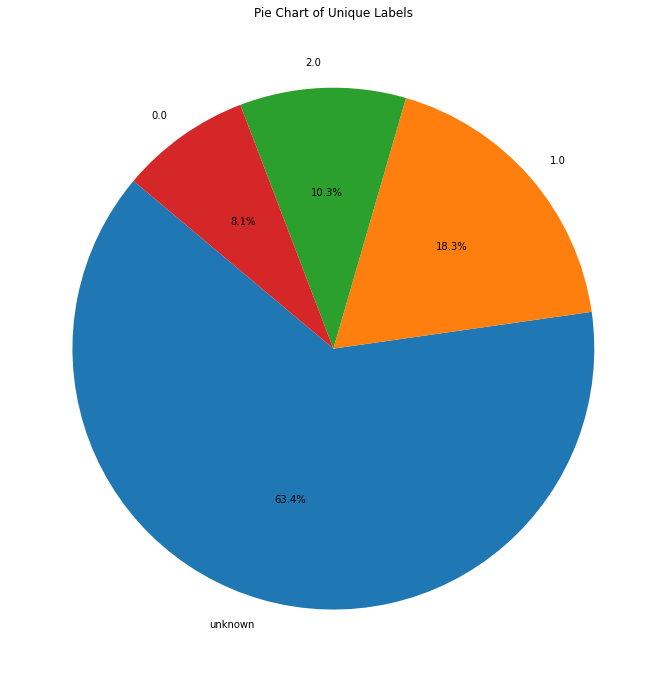

In [52]:
value_counts = df_labels['LABEL'].value_counts()
# Plot a pie chart
plt.figure(figsize=(20, 12))
plt.pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Pie Chart of Unique Labels')
plt.show()

In [53]:
set1 = set(evaluation['CARD'].tolist())
set2 = set(train['CARD'].tolist())
# Find the common elements
common_elements = set1.intersection(set2)
common_elements_list = list(common_elements)
len(common_elements_list)

0

**Dataset Overview:** <br/>
The dataset comprises 3,235 unique credit cards in the training set and 5,595 unique credit cards in the test set, bringing the total to 8,830 credit cards. Notably, these credit cards are not associated with specific dates or any other identifiable information. The objective is to develop a classification model to categorize these credit cards effectively.

# 
**Transactions**

In [54]:
transactions

,Primary_ID,TRX_Type,Date,Time,Amount,Terminal_Type,Terminal_ID,Second_ID
0,9c2594cdb4153de3f748,10,2023/06/02 00:00:00,203918290,11518977.0,7,d7b0230e4491fbd3563a,3de4bc60f38a51a82365
1,a8ae04d3b8f155a154af,10,2023/04/03 00:00:00,191720253,5000000.0,1,9a858e74cc2faefbc12c,b4980da1e29f59c92a53
2,739c869136df74852e10,10,2023/04/29 00:00:00,120418648,2000000.0,1,7cc4db9e78fb590b06a6,69c4a29dd54b44de457e
3,60366904cbdb0d067c20,10,2023/06/02 00:00:00,201139692,1000000.0,1,342abaad6ca26a8aea1e,a59ad5aa2a2b5e221572
4,911abef1ee23db40b108,10,2023/03/22 00:00:00,81928260,50000.0,7,3381cb32e729571bfdfe,8457468be95f8a197756
...,...,...,...,...,...,...,...,...
3259421,6f743892923ae636c1ac,10,2023/03/15 00:00:00,204954592,1000000.0,1,4ff68720afddc796c9fb,42057e17833b83f303f4
3259422,6f743892923ae636c1ac,10,2023/03/25 00:00:00,203016269,2000000.0,1,4ff68720afddc796c9fb,281b90d9fdcc285cca2e
3259423,6f743892923ae636c1ac,10,2023/03/30 00:00:00,121006398,1000000.0,1,4ff68720afddc796c9fb,e32ec72f1bb0e39f0ea3
3259424,6f743892923ae636c1ac,10,2023/04/10 00:00:00,213227613,1000000.0,1,4ff68720afddc796c9fb,071b8737ef9df9a13712


In [55]:
transactions = transactions.drop_duplicates()

In [48]:
data = []
for card in all_cards:
    num_transaction = len(transactions[(transactions['Primary_ID'] == card) | (transactions['Second_ID'] == card)])
    data.append({'Card': card, 'num_transaction': num_transaction})
num_transaction = pd.DataFrame(data)

In [49]:
num_transaction

,Card,num_transaction
0,8e408f075b6872605906,379
1,2c8ab490002745919e9a,40
2,03fe8857991d2994fbf9,472
3,a41d87398962952dc6e2,301
4,a5a2a8417f671a395c38,958
...,...,...
8825,1b30d7dd0f8cf938d7dc,20
8826,64e272dfcf2db4b4d4af,10
8827,77787842a915e581e2b6,10
8828,c618a52c75a225593871,10


In [ ]:
featureAnalysis('num_transaction',num_transaction)

In [ ]:
len(num_transaction[num_transaction['num_transaction'] == 0]['Card'].tolist())

In [65]:
count_train = 0
count_evaluation = 0
for card in num_transaction[num_transaction['num_transaction'] == 0]['Card'].tolist():
    if card in evaluation_cards:
        count_evaluation = count_evaluation + 1 
    elif card in train_cards:
        count_train = count_train + 1 

In [69]:
count_train , count_evaluation

(47, 81)

We lack data for 47 cards in the training set and 81 cards in the test set. Consequently, these records cannot be utilized for model training and evaluation.

In [57]:
transactions.isnull().sum()

Primary_ID            0
TRX_Type              0
Date                  0
Time                  0
Amount                0
Terminal_Type         0
Terminal_ID           0
Second_ID        127382
dtype: int64

In [58]:
transactions.dropna(inplace=True)

In [59]:
print("Unique primary ID " ,transactions['Primary_ID'].nunique())
print("Unique Second ID " ,transactions['Second_ID'].nunique())

Unique primary ID  1165758
Unique Second ID  36937


In [60]:
#Evaluation and train dataset 
df_labels['LABEL'].value_counts()

unknown    5595
1.0        1612
2.0         909
0.0         714
Name: LABEL, dtype: int64

In [61]:
my_dict = dict(zip(df_labels['CARD'], df_labels['LABEL']))

In [62]:
#Use them to label transactions based on primary and second id 
transactions['labelPrimary'] = transactions['Primary_ID'].map(my_dict)
transactions['labelSecond']  = transactions['Second_ID'].map(my_dict)

In [63]:
transactions.isnull().sum()

Primary_ID             0
TRX_Type               0
Date                   0
Time                   0
Amount                 0
Terminal_Type          0
Terminal_ID            0
Second_ID              0
labelPrimary     3076150
labelSecond        45539
dtype: int64

In [64]:
print('null values of labelPrimary : ',transactions.isnull().sum()['labelPrimary'] / len(transactions))
print('null values of labelSecond  : ',transactions.isnull().sum()['labelSecond']   / len(transactions))

null values of labelPrimary :  0.9821541459826235
null values of labelSecond  :  0.014539706338735981


In [65]:
# #Drop null value in labelSecond
# transactions.dropna(subset=['labelSecond'],inplace=True)

In [66]:
#fill
transactions['labelSecond'] = transactions['labelSecond'].fillna('no_info')
transactions['labelPrimary'] = transactions['labelPrimary'].fillna('no_info')

In [67]:
transactions.isnull().sum()

Primary_ID       0
TRX_Type         0
Date             0
Time             0
Amount           0
Terminal_Type    0
Terminal_ID      0
Second_ID        0
labelPrimary     0
labelSecond      0
dtype: int64

# 

<a name="2"></a>
## Features
- [TRX_Type](#2.1)
- [Date](#2.2)
- [Time](#2.3)
- [Amount](#2.4)
- [Terminal_Type](#2.5)
- [Terminal_ID](#2.6)


In [68]:
transactions.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3132044 entries, 0 to 3259425
Data columns (total 10 columns):
 #   Column         Dtype  
---  ------         -----  
 0   Primary_ID     object 
 1   TRX_Type       int64  
 2   Date           object 
 3   Time           int64  
 4   Amount         float64
 5   Terminal_Type  int64  
 6   Terminal_ID    object 
 7   Second_ID      object 
 8   labelPrimary   object 
 9   labelSecond    object 
dtypes: float64(1), int64(3), object(6)
memory usage: 262.9+ MB


In [69]:
encodeData = transactions.copy()

<a name="2.1"></a>
- TRX_Type

In [70]:
transactions['TRX_Type'].value_counts()

10    3132044
Name: TRX_Type, dtype: int64

In [71]:
encodeData = transactions.drop('TRX_Type',axis=1)

<a name="2.2"></a>
- Date

In [72]:
encodeData['timestamp'] = pd.to_datetime(encodeData['Date'])
encodeData['year']   = encodeData['timestamp'].dt.year
encodeData['month']  = encodeData['timestamp'].dt.month
encodeData['day']    = encodeData['timestamp'].dt.day
encodeData['hour']   = encodeData['timestamp'].dt.hour
encodeData['minute'] = encodeData['timestamp'].dt.minute
encodeData['second'] = encodeData['timestamp'].dt.second

In [73]:
print(encodeData['hour'].value_counts()[0]/len(encodeData))  
print(encodeData['minute'].value_counts()[0]/len(encodeData)) 
print(encodeData['second'].value_counts()[0]/len(encodeData)) 

1.0
1.0
1.0


In [74]:
encodeData.drop(['hour','minute','second','Date'],axis=1,inplace=True)

In [75]:
print(encodeData['year'].value_counts()[2023]/len(encodeData))  

1.0


In [76]:
encodeData.drop(['year'],axis=1,inplace=True)

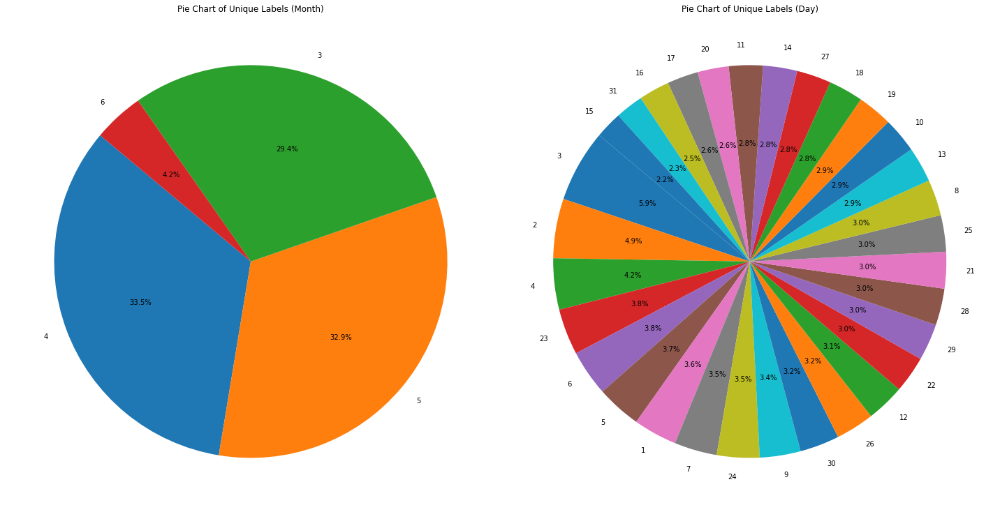

In [77]:
month_value_counts = encodeData['month'].value_counts()
day_value_counts = encodeData['day'].value_counts()
# Create a subplot with 1 row and 2 columns
fig, axs = plt.subplots(1, 2, figsize=(20, 12))
# Plot the pie chart for 'month'
axs[0].pie(month_value_counts, labels=month_value_counts.index, autopct='%1.1f%%', startangle=140)
axs[0].set_title('Pie Chart of Unique Labels (Month)')
# Plot the pie chart for 'day'
axs[1].pie(day_value_counts, labels=day_value_counts.index, autopct='%1.1f%%', startangle=140)
axs[1].set_title('Pie Chart of Unique Labels (Day)')
plt.tight_layout()
plt.show()

In [78]:
print('From ' , str(encodeData['timestamp'].min()), ' to ' , str(encodeData['timestamp'].max()))

From  2023-03-03 00:00:00  to  2023-06-03 00:00:00


# 

<a name="2.3"></a>
- Time

,count,mean,std,min,25%,50%,75%,max
Time,3132044.0,1.425251e+08,6.277456e+07,101.0,103934177.5,150911684.5,1.938147e+08,235959990.0


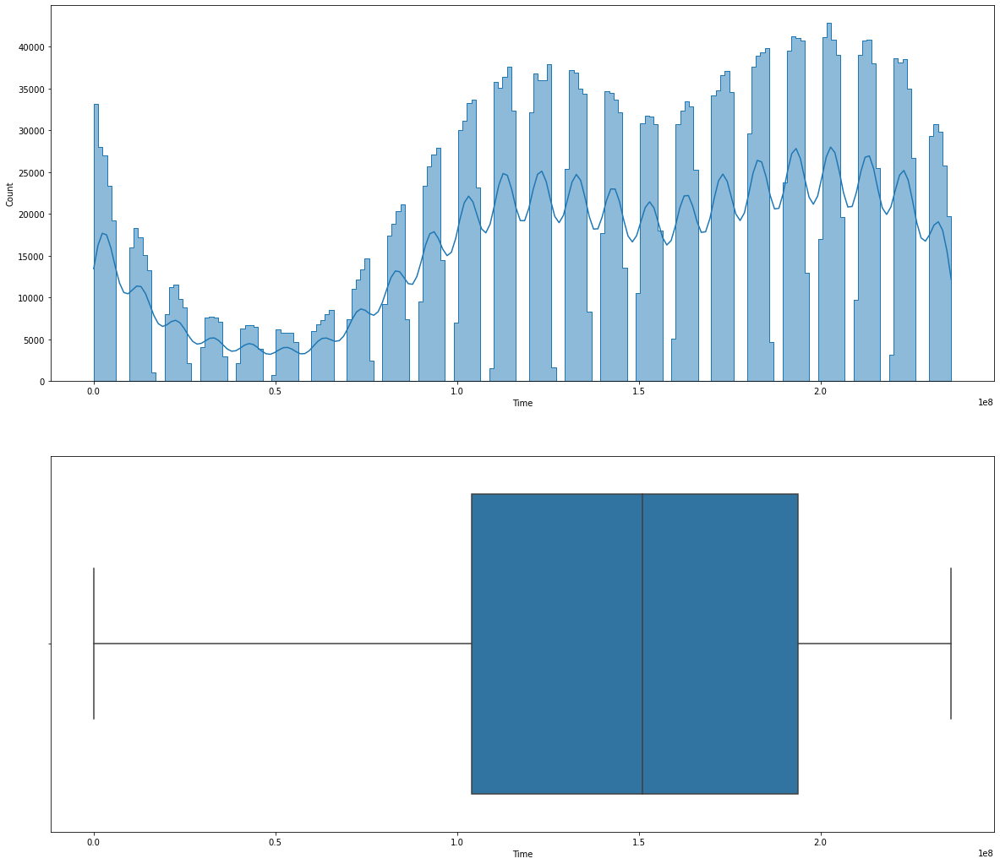

In [79]:
featureAnalysis('Time',encodeData)

In [80]:
encodeData['Time'] = pd.to_datetime(encodeData['Time'], unit='ms')
encodeData['Hour'] = encodeData['Time'].dt.hour
encodeData['Minute'] = encodeData['Time'].dt.minute
encodeData['Second'] = encodeData['Time'].dt.second
encodeData['Microsecond'] = encodeData['Time'].dt.microsecond

In [81]:
encodeData['Hour'].value_counts()

10    185999
13    183953
0     182449
2     180473
5     179480
7     167197
8     160941
16    149945
3     147103
4     138206
23    135487
11    133677
6     130174
15    120623
9     119810
1     117614
12    111223
14    108091
21    102163
18    100263
20     90623
17     87984
22     51090
19     47476
Name: Hour, dtype: int64

In [166]:
hour_mean_amount = encodeData.groupby('Hour')['Amount'].mean().to_dict()
encodeData['hour_mean_amount'] = encodeData['Hour'].map(hour_mean_amount)

In [167]:
hour_mean_amount

{0: 7172056.625544673,
 1: 7743070.839330352,
 2: 6946985.676793759,
 3: 6455357.925202069,
 4: 7549989.855476608,
 5: 6678568.505688656,
 6: 6756510.638145866,
 7: 7298404.149721586,
 8: 6275764.800181433,
 9: 7055848.177931725,
 10: 6964539.866386378,
 11: 5876262.7644620985,
 12: 6973028.758754934,
 13: 6518307.733013324,
 14: 5862899.363573286,
 15: 6646526.486864031,
 16: 6213975.608743206,
 17: 6036591.60526914,
 18: 6691965.274667624,
 19: 6597425.584042463,
 20: 6756720.920858943,
 21: 6660163.199759209,
 22: 7573531.1495596,
 23: 7101789.400769077}

In [82]:
encodeData.drop('Time',axis=1,inplace=True)

In [83]:
bin_edges = [-1, 2, 5, 8, 11, 14, 17, 20 , 23]
bin_labels = [1, 2, 3, 4, 5, 6, 7, 8]
encodeData['hour_binned'] = pd.cut(encodeData['Hour'], bins=bin_edges, labels=bin_labels, include_lowest=True)

In [84]:
encodeData['hour_binned'].value_counts()

1    480536
2    464789
3    458312
4    439486
5    403267
6    358552
8    288740
7    238362
Name: hour_binned, dtype: int64

In [85]:
encodeData['hour_binned'] = encodeData['hour_binned'].astype(int)

In [164]:
hour_binned_mean_amount = encodeData.groupby('hour_binned')['Amount'].mean().to_dict()
encodeData['hour_binned_mean_amount'] = encodeData['hour_binned'].map(hour_binned_mean_amount)

In [165]:
hour_binned_mean_amount

{1: 7227286.694480746,
 2: 6867042.658578409,
 3: 6785380.171448708,
 4: 6658414.143729266,
 5: 6468047.46025338,
 6: 6315965.363116089,
 7: 6697754.723374532,
 8: 7029002.216353813}

In [86]:
encodeData['year'] = 2023
encodeData['combined_timestamp'] = pd.to_datetime(encodeData[['year','month', 'day', 'Hour', 'Minute', 'Second', 'Microsecond']])
encodeData.drop('timestamp',axis=1,inplace=True)

In [87]:
encodeData['day_of_week'] = encodeData['combined_timestamp'].dt.dayofweek

In [88]:
encodeData['day_of_week'].value_counts()

1    505420
2    475799
4    475074
5    469027
6    435735
3    418099
0    352890
Name: day_of_week, dtype: int64

In [162]:
day_of_week_mean_amount = encodeData.groupby('day_of_week')['Amount'].mean().to_dict()
encodeData['day_of_week_mean_amount'] = encodeData['day_of_week'].map(day_of_week_mean_amount)

In [163]:
day_of_week_mean_amount

{0: 5845285.036603474,
 1: 6935631.210242966,
 2: 6841315.159346699,
 3: 6923043.558107051,
 4: 6985867.497408825,
 5: 6923861.785713829,
 6: 6691577.917621949}

<a name="2.4"></a>
- Amount

,count,mean,std,min,25%,50%,75%,max
Amount,3132044.0,6.768677e+06,1.383031e+07,1.0,1000000.0,2000000.0,6000000.0,150000000.0


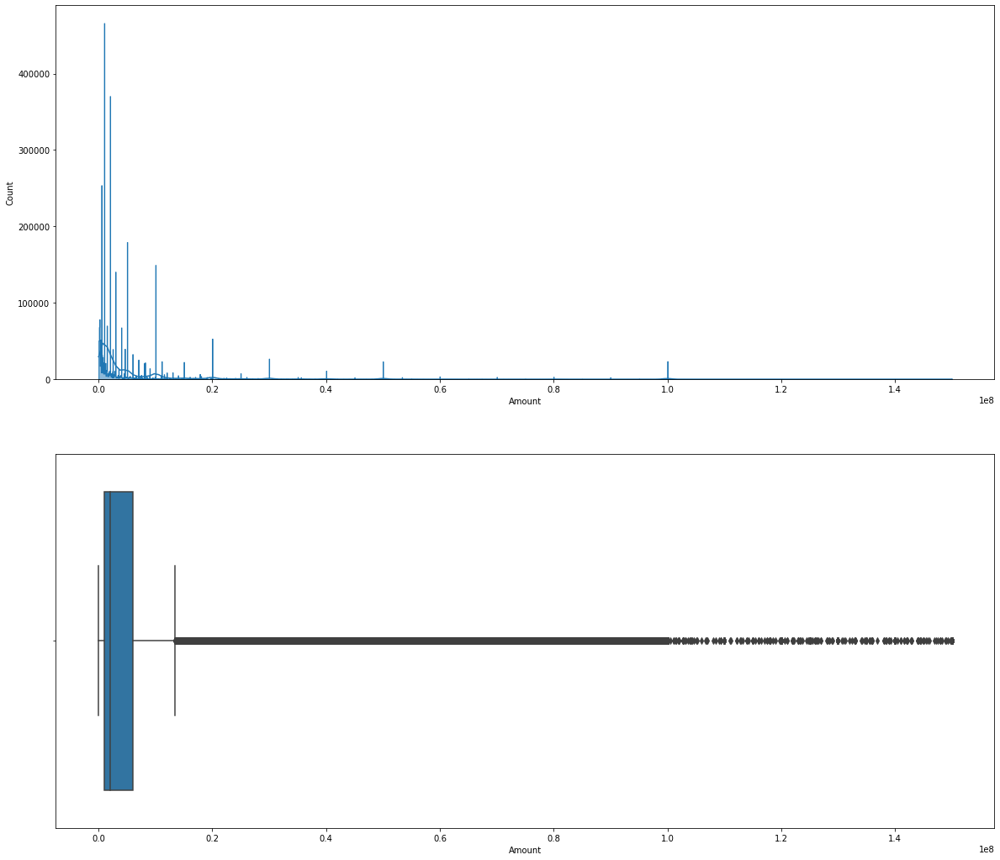

In [89]:
featureAnalysis('Amount',encodeData)

In [90]:
encodeData['log_Amount'] = np.log(encodeData['Amount'])

,count,mean,std,min,25%,50%,75%,max
log_Amount,3132044.0,14.627525,1.519028,0.0,13.815511,14.508658,15.60727,18.826146


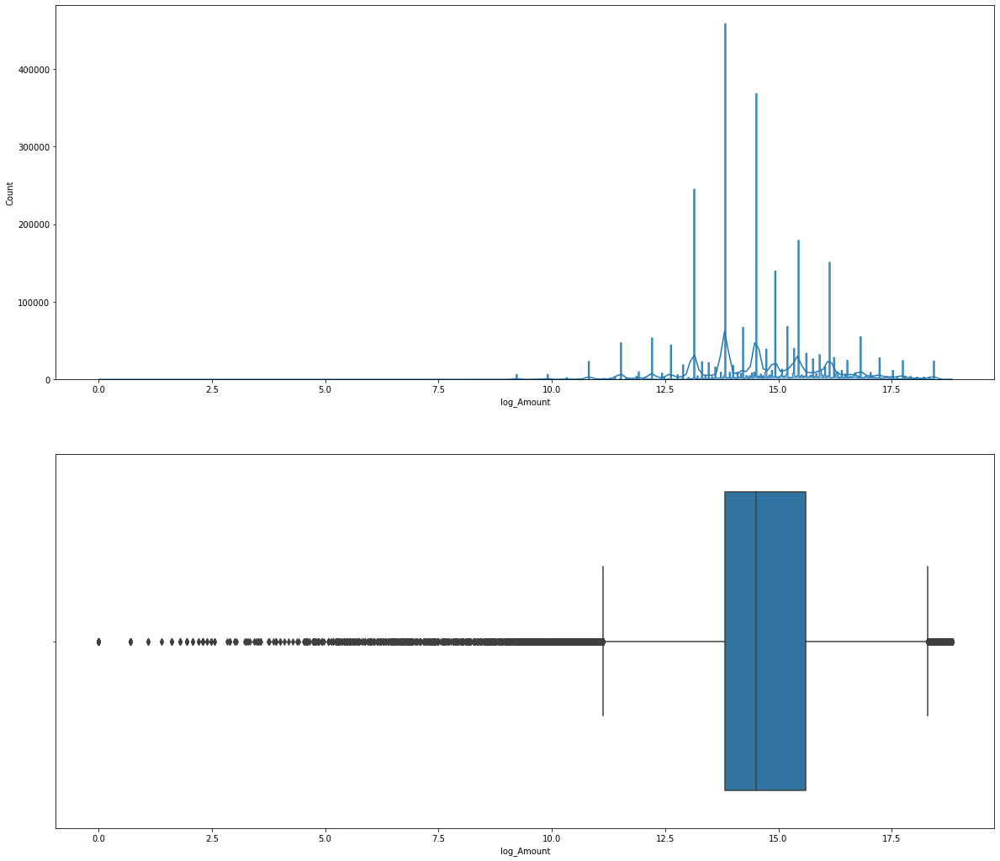

In [91]:
featureAnalysis('log_Amount',encodeData)

# 

<a name="2.5"></a>
- Terminal_Type

In [92]:
encodeData['Terminal_Type'].value_counts()

1    2249372
7     834993
6      32215
5      15464
Name: Terminal_Type, dtype: int64

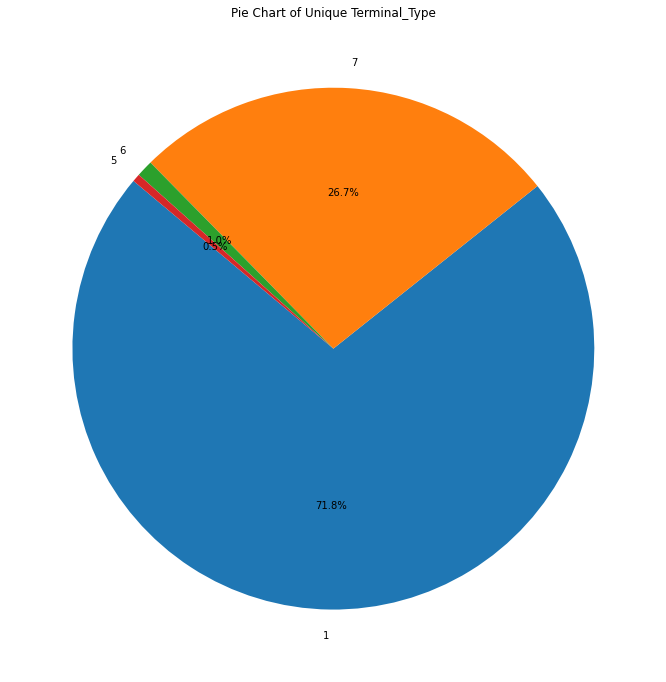

In [93]:
value_counts = encodeData['Terminal_Type'].value_counts()
# Plot a pie chart
plt.figure(figsize=(20, 12))
plt.pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Pie Chart of Unique Terminal_Type')
plt.show()

In [161]:
terminal_Type_mean_amount = encodeData.groupby('Terminal_Type')['Amount'].mean().to_dict()
encodeData['terminal_Type_mean_amount'] = encodeData['Terminal_Type'].map(terminal_Type_mean_amount)

<a name="2.6"></a> 
 - Terminal_ID

In [94]:
value_count_Terminal_ID = pd.DataFrame(encodeData['Terminal_ID'].value_counts())

,count,mean,std,min,25%,50%,75%,max
Terminal_ID,68951.0,45.4242,2299.761765,1.0,2.0,5.0,13.0,518407.0


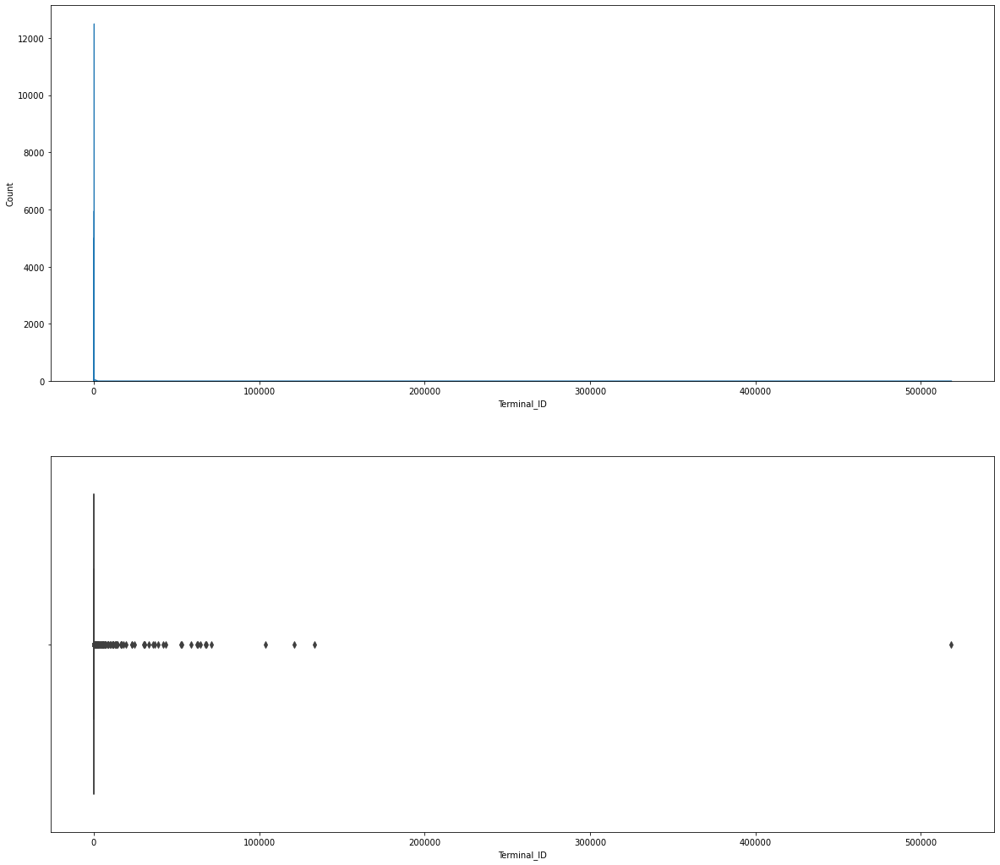

In [95]:
featureAnalysis('Terminal_ID',value_count_Terminal_ID)

In [96]:
len(value_count_Terminal_ID[value_count_Terminal_ID['Terminal_ID'] < 100]) / len(value_count_Terminal_ID)

0.9858160142710041

In [97]:
#Frequency Encoding 
terminal_id_counts = encodeData['Terminal_ID'].value_counts().to_dict()
encodeData['Terminal_ID_Count'] = encodeData['Terminal_ID'].map(terminal_id_counts)

In [150]:
terminal_id_mean_amount = encodeData.groupby('Terminal_ID')['Amount'].mean().to_dict()
encodeData['terminal_id_mean_amount'] = encodeData['Terminal_ID'].map(terminal_id_mean_amount)

- Primary ID and Second ID

In [98]:
#Frequency Encoding Primary_ID
Primary_ID_counts = encodeData['Primary_ID'].value_counts().to_dict()
encodeData['Primary_ID_counts'] = encodeData['Primary_ID'].map(Primary_ID_counts)

In [99]:
#Frequency Encoding Second_ID
Second_ID_counts = encodeData['Second_ID'].value_counts().to_dict()
encodeData['Second_ID_counts'] = encodeData['Second_ID'].map(Second_ID_counts)

**Phase Two**

In [151]:
encodeData

,Primary_ID,Amount,Terminal_Type,Terminal_ID,Second_ID,labelPrimary,labelSecond,month,day,Hour,...,year,combined_timestamp,day_of_week,log_Amount,Terminal_ID_Count,Primary_ID_counts,Second_ID_counts,anomaly_score,anomaly_prediction,terminal_id_mean_amount
0,9c2594cdb4153de3f748,11518977.0,7,d7b0230e4491fbd3563a,3de4bc60f38a51a82365,no_info,unknown,6,2,8,...,2023,2023-06-02 08:38:38.290,4,16.259506,141,1,75392,0.069182,1,5.451315e+06
1,a8ae04d3b8f155a154af,5000000.0,1,9a858e74cc2faefbc12c,b4980da1e29f59c92a53,no_info,0.0,4,3,5,...,2023,2023-04-03 05:15:20.253,0,15.424948,36688,1,16529,0.153870,1,5.460239e+06
2,739c869136df74852e10,2000000.0,1,7cc4db9e78fb590b06a6,69c4a29dd54b44de457e,no_info,unknown,4,29,9,...,2023,2023-04-29 09:26:58.648,5,14.508658,67492,1,286,0.157656,1,7.088591e+06
3,60366904cbdb0d067c20,1000000.0,1,342abaad6ca26a8aea1e,a59ad5aa2a2b5e221572,no_info,unknown,6,2,7,...,2023,2023-06-02 07:52:19.692,4,13.815511,133456,1,7174,0.139557,1,6.466540e+06
4,911abef1ee23db40b108,50000.0,7,3381cb32e729571bfdfe,8457468be95f8a197756,no_info,unknown,3,22,22,...,2023,2023-03-22 22:45:28.260,2,10.819778,89,1,34702,0.048274,1,1.189212e+07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3259421,6f743892923ae636c1ac,1000000.0,1,4ff68720afddc796c9fb,42057e17833b83f303f4,no_info,unknown,3,15,8,...,2023,2023-03-15 08:55:54.592,2,13.815511,8877,14,789,0.167978,1,4.401098e+06
3259422,6f743892923ae636c1ac,2000000.0,1,4ff68720afddc796c9fb,281b90d9fdcc285cca2e,no_info,unknown,3,25,8,...,2023,2023-03-25 08:23:36.269,5,14.508658,8877,14,352,0.178442,1,4.401098e+06
3259423,6f743892923ae636c1ac,1000000.0,1,4ff68720afddc796c9fb,e32ec72f1bb0e39f0ea3,no_info,unknown,3,30,9,...,2023,2023-03-30 09:36:46.398,3,13.815511,8877,14,656,0.165481,1,4.401098e+06
3259424,6f743892923ae636c1ac,1000000.0,1,4ff68720afddc796c9fb,071b8737ef9df9a13712,no_info,1.0,4,10,11,...,2023,2023-04-10 11:13:47.613,0,13.815511,8877,14,504,0.192692,1,4.401098e+06


In [152]:
df_clustering = encodeData[['Amount', 'Terminal_Type', 'month', 'day', 'Hour',
       'Minute', 'Second', 'Microsecond', 'hour_binned', 'log_Amount',
       'Terminal_ID_Count', 'Primary_ID_counts', 'Second_ID_counts','terminal_id_mean_amount']]

In [153]:
df_encoded = pd.get_dummies(df_clustering, columns=['Terminal_Type'], prefix='Terminal_Type')

In [171]:
df_encoded

,Amount,month,day,Hour,Minute,Second,Microsecond,hour_binned,log_Amount,Terminal_ID_Count,Primary_ID_counts,Second_ID_counts,terminal_id_mean_amount,Terminal_Type_1,Terminal_Type_5,Terminal_Type_6,Terminal_Type_7,anomaly_score,anomaly_prediction
0,11518977.0,6,2,8,38,38,290000,3,16.259506,141,1,75392,5.451315e+06,0,0,0,1,0.083201,1
1,5000000.0,4,3,5,15,20,253000,2,15.424948,36688,1,16529,5.460239e+06,1,0,0,0,0.186149,1
2,2000000.0,4,29,9,26,58,648000,4,14.508658,67492,1,286,7.088591e+06,1,0,0,0,0.172143,1
3,1000000.0,6,2,7,52,19,692000,3,13.815511,133456,1,7174,6.466540e+06,1,0,0,0,0.136166,1
4,50000.0,3,22,22,45,28,260000,8,10.819778,89,1,34702,1.189212e+07,0,0,0,1,0.059287,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3259421,1000000.0,3,15,8,55,54,592000,3,13.815511,8877,14,789,4.401098e+06,1,0,0,0,0.187089,1
3259422,2000000.0,3,25,8,23,36,269000,3,14.508658,8877,14,352,4.401098e+06,1,0,0,0,0.195967,1
3259423,1000000.0,3,30,9,36,46,398000,4,13.815511,8877,14,656,4.401098e+06,1,0,0,0,0.180650,1
3259424,1000000.0,4,10,11,13,47,613000,4,13.815511,8877,14,504,4.401098e+06,1,0,0,0,0.208458,1


In [155]:
anomalyFeatures = df_encoded.columns.tolist()

In [172]:
len(anomalyFeatures)

17

In [173]:
model = IsolationForest(contamination=0.01, random_state=42)
model.fit(df_encoded[anomalyFeatures])

IsolationForest(contamination=0.01, random_state=42)

In [174]:
# Predict outliers (anomalies)
df_encoded['anomaly_score'] = model.decision_function(df_encoded[anomalyFeatures])
df_encoded['anomaly_prediction'] = model.predict(df_encoded[anomalyFeatures])

In [175]:
df_encoded['anomaly_prediction'].value_counts()

 1    3100723
-1      31321
Name: anomaly_prediction, dtype: int64

In [176]:
df_encoded.shape 

(3132044, 19)

# 

<a name="3"></a>

### Graph Based Features

In [177]:
df = encodeData.copy()

In [178]:
def count_unique_primary(encodeData_0 , baseCard):
    Primary_ID = encodeData_0['Primary_ID'].unique().tolist()
    Primary_ID = [x for x in Primary_ID if x != baseCard]
    unique_values_count = len(set(Primary_ID))
    return unique_values_count

In [179]:
def count_unique_second(encodeData_0 , baseCard):
    Second_ID = encodeData_0['Second_ID'].unique().tolist()
    Second_ID = [x for x in Second_ID if x != baseCard]
    unique_values_count = len(set(Second_ID))
    return unique_values_count

In [180]:
all_cards = df_labels['CARD'].unique().tolist()

In [181]:
len(all_cards)

8830

In [184]:
df_sorted = encodeData_0.sort_values(by='combined_timestamp')

In [185]:
time_diffs = np.diff(df_sorted['combined_timestamp'].tolist()).astype('timedelta64[us]').astype(int)
std_deviation = np.std(time_diffs)
print(f"Standard Deviation of Time Differences: {std_deviation}")

Standard Deviation of Time Differences: 1298647203.9183593


In [186]:
all_feature_dicts = []
count_empty = 0
for card in tqdm(all_cards, desc="Processing cards"):
    encodeData_0 = df[(df['Primary_ID'] == card) | (df['Second_ID'] == card)]
    if len(encodeData_0) == 0:
        count_empty = count_empty + 1
    else:
        encodeData_0['basedCard'] = card
        encodeData_0['received'] = encodeData_0.apply(lambda row: 0 if row['basedCard'] == row['Primary_ID'] else (1 if row['basedCard'] == row['Second_ID'] else None), axis=1)
        feature_dict = {}
        #Card
        feature_dict['Card'] = card
        #Count transaction
        feature_dict['count_total']   = len(encodeData_0)
        feature_dict['count_received'] = encodeData_0['received'].sum()
        feature_dict['count_given']   = len(encodeData_0) - encodeData_0['received'].sum()
        
        #given and received dataset
        received = encodeData_0[encodeData_0['received'] == 0]
        given    = encodeData_0[encodeData_0['received'] == 1]
        
        #Mean Amount
        feature_dict['mean_total']    = encodeData_0['Amount'].mean()
        feature_dict['mean_given']    = given['Amount'].mean()
        feature_dict['mean_received'] = received['Amount'].mean()
        
        #STD Amount
        feature_dict['std_total']    = encodeData_0['Amount'].std()
        feature_dict['std_given']    = given['Amount'].std()
        feature_dict['std_received'] = received['Amount'].std()
        
        #Mean Minute
        feature_dict['mean_total_minute']    = encodeData_0['Minute'].mean()
        feature_dict['mean_given_minute']    = given['Minute'].mean()
        feature_dict['mean_received_minute'] = received['Minute'].mean()
        
        #Mean hour 
        feature_dict['mean_total_hour']    = encodeData_0['Hour'].mean()
        feature_dict['mean_given_hour']    = given['Hour'].mean()
        feature_dict['mean_received_hour'] = received['Hour'].mean()
        
        #Mean hour bin
        feature_dict['mean_total_hourBin']    = encodeData_0['hour_binned'].mean()
        feature_dict['mean_given_hourBin']    = given['hour_binned'].mean()
        feature_dict['mean_received_hourBin'] = received['hour_binned'].mean()
        #STD all time 
        df_sorted = encodeData_0.sort_values(by='combined_timestamp')
        time_diffs = np.diff(df_sorted['combined_timestamp'].tolist()).astype('timedelta64[us]').astype(int)
        feature_dict['std_combined'] = np.std(time_diffs)
        
        #STD hour
        feature_dict['std_total_hour']   = encodeData_0['Hour'].std()
        feature_dict['std_given_hour']   = given['Hour'].std()
        feature_dict['std_recived_hour'] = received['Hour'].std()
        #STD hour amoumt
        feature_dict['std_total_hour_amt']    = encodeData_0.groupby('Hour')['Amount'].std().mean()
        feature_dict['std_given_hour_amt']    = given.groupby('Hour')['Amount'].std().mean()
        feature_dict['std_received_hour_amt'] = received.groupby('Hour')['Amount'].std().mean()

        #Mean Day
        feature_dict['mean_total_day']   = encodeData_0['day'].mean()
        feature_dict['mean_given_day']   = given['day'].mean()
        feature_dict['mean_recived_day'] = received['day'].mean()
        
        #STD Day
        feature_dict['std_total_day']    = encodeData_0['day'].std()
        feature_dict['std_given_day']    = given['day'].std()
        feature_dict['std_received_day'] = received['day'].std()
        #STD day amoumt
        feature_dict['std_total_day_amt']    = encodeData_0.groupby('day')['Amount'].std().mean()
        feature_dict['std_given_day_amt']    = given.groupby('day')['Amount'].std().mean()
        feature_dict['std_received_day_amt'] = received.groupby('day')['Amount'].std().mean()
        
        #Mean Month
        feature_dict['mean_total_month']    = encodeData_0['month'].mean()
        feature_dict['mean_given_month']    = given['month'].mean()
        feature_dict['mean_received_month'] = received['month'].mean()
        #STD month amoumt
        feature_dict['std_total_month_amt']    = encodeData_0.groupby('month')['Amount'].std().mean()
        feature_dict['std_given_month_amt']    = given.groupby('month')['Amount'].std().mean()
        feature_dict['std_received_month_amt'] = received.groupby('month')['Amount'].std().mean()
        
        #Unique Terminal type
        feature_dict['count_total_termnialType']    = encodeData_0['Terminal_Type'].nunique()
        feature_dict['count_given_termnialType']    = given['Terminal_Type'].nunique()
        feature_dict['count_received_termnialType'] = received['Terminal_Type'].nunique()

        
        #Unique Terminal id
        feature_dict['count_total_termnialID']    = encodeData_0['Terminal_ID'].nunique()
        feature_dict['count_given_termnialID']    = given['Terminal_ID'].nunique()
        feature_dict['count_received_termnialID'] = received['Terminal_ID'].nunique()
        #Mean frequency terminal ID 
        feature_dict['mean_total_termnialID_count']    = encodeData_0['Terminal_ID_Count'].mean()
        feature_dict['mean_given_termnialID_count']    = given['Terminal_ID_Count'].mean()
        feature_dict['mean_received_termnialID_count'] = received['Terminal_ID_Count'].mean()
        
        #Count unique ID
        feature_dict['count_unique_secondID']  = count_unique_second(encodeData_0 , card)
        feature_dict['count_unique_primaryID'] = count_unique_primary(encodeData_0 , card)
        feature_dict['count_unique_ID'] = feature_dict['count_unique_secondID'] + feature_dict['count_unique_primaryID']
        #Mean frequency primary ID
        feature_dict['mean_total_Primary_ID_counts']    = encodeData_0['Primary_ID_counts'].mean()
        feature_dict['mean_given_Primary_ID_counts']    = given['Primary_ID_counts'].mean()
        feature_dict['mean_received_Primary_ID_counts'] = received['Primary_ID_counts'].mean()
        #Mean frequency second ID
        feature_dict['mean_total_Second_ID_counts_counts']    = encodeData_0['Second_ID_counts'].mean()
        feature_dict['mean_given_Second_ID_counts_counts']    = given['Second_ID_counts'].mean()
        feature_dict['mean_received_Second_ID_counts_counts'] = received['Second_ID_counts'].mean()  
        
        #Time Range
        feature_dict['min_time_day']  = encodeData_0['combined_timestamp'].min().day
        feature_dict['min_time_hour'] = encodeData_0['combined_timestamp'].min().hour
        feature_dict['max_time_day']  = encodeData_0['combined_timestamp'].max().day
        feature_dict['max_time_hour'] = encodeData_0['combined_timestamp'].max().hour
        feature_dict['std_time']      = np.std((encodeData_0['combined_timestamp'] - encodeData_0['combined_timestamp'].min()).dt.days)
        feature_dict['range_time']    = (encodeData_0['combined_timestamp'].max() - encodeData_0['combined_timestamp'].min()).days
        
        #mean each terminalType
        feature_dict['type_1'] = encodeData_0[encodeData_0['Terminal_Type'] == 1]['Amount'].mean()  
        feature_dict['type_5'] = encodeData_0[encodeData_0['Terminal_Type'] == 5]['Amount'].mean() 
        feature_dict['type_6'] = encodeData_0[encodeData_0['Terminal_Type'] == 6]['Amount'].mean()
        feature_dict['type_7'] = encodeData_0[encodeData_0['Terminal_Type'] == 7]['Amount'].mean()
        
        #mean frequency encoding
        
        #Time series features 
        # Autocorrelation Features
        encodeData_0['lag_1'] = encodeData_0['Amount'].shift(1)
        encodeData_0['lag_2'] = encodeData_0['Amount'].shift(2)
        feature_dict['autocorrelation_lag_1'] = encodeData_0['Amount'].autocorr(1)
        feature_dict['autocorrelation_lag_2'] = encodeData_0['Amount'].autocorr(2)
        
        #Number of pairs 
        encodeData_0['Pair'] = encodeData_0.apply(lambda row: tuple(sorted([row['Primary_ID'], row['Second_ID']])), axis=1)
        pair_counts = encodeData_0['Pair'].value_counts()
        pair_counts = pair_counts[pair_counts > 1]
        pair_freq_dict = pair_counts.to_dict()
        if not pair_freq_dict:
            feature_dict['Max_Pair_Frequency'] = 0
            feature_dict['Num_Pairs'] = len(encodeData_0)
        else:
            feature_dict['Max_Pair_Frequency'] = encodeData_0['Pair'].map(pair_freq_dict)
            feature_dict['Num_Pairs'] = encodeData_0['Pair'].map(pair_counts)

        #Anomaly detection total
        feature_dict['isolation_anomaly_total'] = len(encodeData_0[encodeData_0['anomaly_prediction'] == -1])
        feature_dict['isolation_normal_total']  = len(encodeData_0[encodeData_0['anomaly_prediction'] ==  1])
        feature_dict['isolation_mean_total'] = encodeData_0['anomaly_score'].mean()
        feature_dict['isolation_std_total']  = encodeData_0['anomaly_score'].std()
        #Anomaly detection given
        feature_dict['isolation_anomaly_given'] = len(given[given['anomaly_prediction'] == -1])
        feature_dict['isolation_normal_given']  = len(given[given['anomaly_prediction'] ==  1])
        feature_dict['isolation_mean_given'] = given['anomaly_score'].mean()
        feature_dict['isolation_std_given']  = given['anomaly_score'].std() 
        #Anomaly detection received
        feature_dict['isolation_anomaly_received'] = len(received[received['anomaly_prediction'] == -1])
        feature_dict['isolation_normal_received']  = len(received[received['anomaly_prediction'] ==  1])
        feature_dict['isolation_mean_received'] = received['anomaly_score'].mean()
        feature_dict['isolation_std_received']  = received['anomaly_score'].std() 
        #Label
        feature_dict['label'] = df_labels[df_labels['CARD'] == card]['LABEL'].values[0]

    all_feature_dicts.append(feature_dict)
print('8830 rows except ' , count_empty)

Processing cards: 100%|██████████████████████████████████████████████████████████| 8830/8830 [1:35:57<00:00,  1.53it/s]

8830 rows except  128


In [187]:
features_df = pd.DataFrame(all_feature_dicts)

In [188]:
features_df.drop(['Max_Pair_Frequency', 'Num_Pairs'],axis=1,inplace=True)

In [189]:
features_df.to_csv('featuresDF_v2.csv')

In [21]:
# features_df = pd.read_csv('featuresDF_v2.csv')

In [190]:
features_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8830 entries, 0 to 8829
Data columns (total 84 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   Card                                   8830 non-null   object 
 1   count_total                            8830 non-null   int64  
 2   count_received                         8830 non-null   int64  
 3   count_given                            8830 non-null   int64  
 4   mean_total                             8830 non-null   float64
 5   mean_given                             8606 non-null   float64
 6   mean_received                          4226 non-null   float64
 7   std_total                              8611 non-null   float64
 8   std_given                              8329 non-null   float64
 9   std_received                           3319 non-null   float64
 10  mean_total_minute                      8830 non-null   float64
 11  mean

<a name="4"></a>
### Train the models

In [191]:
features_df_fillZero = features_df.fillna(0)

In [192]:
features_df_fillZero = features_df_fillZero.drop_duplicates()

In [25]:
# features_df_fillZero.drop('Unnamed: 0',axis=1,inplace=True)

In [238]:
features_df_train = features_df_fillZero[features_df_fillZero['label'] != 'unknown']
features_df_test = features_df_fillZero[features_df_fillZero['label'] == 'unknown']

In [339]:
features_df_test

,Card,count_total,count_received,count_given,mean_total,mean_given,mean_received,std_total,std_given,std_received,mean_total_minute,mean_given_minute,mean_received_minute,mean_total_hour,mean_given_hour,mean_received_hour,mean_total_hourBin,mean_given_hourBin,mean_received_hourBin,std_combined,std_total_hour,std_given_hour,std_recived_hour,std_total_hour_amt,std_given_hour_amt,std_received_hour_amt,mean_total_day,mean_given_day,mean_recived_day,std_total_day,std_given_day,std_received_day,std_total_day_amt,std_given_day_amt,std_received_day_amt,mean_total_month,mean_given_month,mean_received_month,std_total_month_amt,std_given_month_amt,std_received_month_amt,count_total_termnialType,count_given_termnialType,count_received_termnialType,count_total_termnialID,count_given_termnialID,count_received_termnialID,mean_total_termnialID_count,mean_given_termnialID_count,mean_received_termnialID_count,count_unique_secondID,count_unique_primaryID,count_unique_ID,mean_total_Primary_ID_counts,mean_given_Primary_ID_counts,mean_received_Primary_ID_counts,mean_total_Second_ID_counts_counts,mean_given_Second_ID_counts_counts,mean_received_Second_ID_counts_counts,min_time_day,min_time_hour,max_time_day,max_time_hour,std_time,range_time,type_1,type_5,type_6,type_7,autocorrelation_lag_1,autocorrelation_lag_2,isolation_anomaly_total,isolation_normal_total,isolation_mean_total,isolation_std_total,isolation_anomaly_given,isolation_normal_given,isolation_mean_given,isolation_std_given,isolation_anomaly_received,isolation_normal_received,isolation_mean_received,isolation_std_received,label
0,8e408f075b6872605906,379,379,0,6.765011e+06,6.765011e+06,0.000000e+00,1.108423e+07,1.108423e+07,0.000000e+00,26.670185,26.670185,0.000000,8.691293,8.691293,0.000000,3.620053,3.620053,0.000000,6.088505e+08,6.992604,6.992604,0.000000,9.353215e+06,9.353215e+06,0.000000e+00,9.456464,9.456464,0.000000,3.441127,3.441127,0.000000,1.106446e+07,1.106446e+07,0.000000e+00,3.000000,3.000000,0.000000,1.108423e+07,1.108423e+07,0.000000e+00,3,3,0,85,85,0,119234.097625,119234.097625,0.000000,0,260,260,32.237467,32.237467,0.0,379.000000,379.0,0.000000,6,0,14,23,3.427249,8,6.445354e+06,0.000000e+00,3.200000e+06,9.407143e+06,1.442468e-01,-1.039015e-02,0,379,0.127844,0.033881,0,379,0.127844,0.033881,0,0,0.000000,0.000000,unknown
1,2c8ab490002745919e9a,40,37,3,1.100250e+07,8.300000e+06,4.433333e+07,1.432571e+07,1.081162e+07,9.814955e+06,29.925000,29.972973,29.333333,9.250000,9.567568,5.333333,3.725000,3.837838,2.333333,1.298647e+09,5.619335,5.510296,6.658328,1.288736e+07,9.965344e+06,0.000000e+00,23.650000,24.270270,16.000000,5.361544,4.457507,10.392305,1.429883e+07,9.239804e+06,0.000000e+00,3.025000,3.000000,3.333333,1.405582e+07,1.081162e+07,0.000000e+00,1,1,1,20,18,2,184853.500000,195702.486486,51049.333333,3,35,38,5.125000,5.297297,3.0,56.450000,37.0,296.333333,21,2,4,13,4.595582,14,1.100250e+07,0.000000e+00,0.000000e+00,0.000000e+00,4.155332e-01,2.629263e-01,0,40,0.129605,0.034497,0,37,0.132497,0.033509,0,3,0.093926,0.030497,unknown
2,03fe8857991d2994fbf9,472,472,0,7.597919e+06,7.597919e+06,0.000000e+00,1.506568e+07,1.506568e+07,0.000000e+00,29.809322,29.809322,0.000000,9.529661,9.529661,0.000000,3.885593,3.885593,0.000000,4.225364e+08,5.430820,5.430820,0.000000,1.363141e+07,1.363141e+07,0.000000e+00,13.245763,13.245763,0.000000,11.236834,11.236834,0.000000,1.491675e+07,1.491675e+07,0.000000e+00,3.466102,3.466102,0.000000,1.505629e+07,1.505629e+07,0.000000e+00,3,3,0,106,106,0,137979.832627,137979.832627,0.000000,0,300,300,34.911017,34.911017,0.0,472.000000,472.0,0.000000,21,2,2,23,5.099512,12,6.994113e+06,0.000000e+00,5.400000e+05,1.162032e+07,4.517432e-02,1.801052e-02,0,472,0.128120,0.037127,0,472,0.128120,0.037127,0,0,0.000000,0.000000,unknown
3,a41d87398962952dc6e2,301,301,0,8.775982e+06,8.775982e+06,0.000000e+00,1.634866e+07,1.634866e+07,0.000000e+00,27.495017,27.495017,0.000000,10.807309,10.807309,0.000000,4.269103,4.269103,0.000000,8.071355e+08,6.437086,6.437086,0.000000,1.

In [ ]:
X_evaluation = features_df_train.iloc[:, 1:-1]


In [239]:
len(features_df_train) , len(features_df_test) 

(3188, 5514)

In [338]:
y.value_counts()

1.0    1612
2.0     862
0.0     714
Name: label, dtype: int64

In [289]:
X = features_df_train.iloc[:, 1:-1]
y = features_df_train['label']

In [290]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [291]:
X_train.shape

(2550, 82)

In [293]:
y_train = y_train.astype(int)
y_test = y_test.astype(int)

**Random Forest**

In [294]:
rf = RandomForestClassifier(n_estimators=500, random_state=42)
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
y_prob = rf.predict_proba(X_test)[:, 1]
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average=None)
print('accuracy : ' ,accuracy)
print("Classification Report:\n", classification_report(y_test, y_pred))

accuracy :  0.9404388714733543
Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.86      0.87       131
           1       0.99      0.99      0.99       343
           2       0.90      0.90      0.90       164

    accuracy                           0.94       638
   macro avg       0.92      0.92      0.92       638
weighted avg       0.94      0.94      0.94       638



In [268]:
rf = RandomForestClassifier(n_estimators=500, random_state=42)
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
y_prob = rf.predict_proba(X_test)[:, 1]
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average=None)
print('accuracy : ' ,accuracy)
print("Classification Report:\n", classification_report(y_test, y_pred))

accuracy :  0.9404388714733543
Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.86      0.87       131
           1       0.99      0.99      0.99       343
           2       0.90      0.90      0.90       164

    accuracy                           0.94       638
   macro avg       0.92      0.92      0.92       638
weighted avg       0.94      0.94      0.94       638



In [254]:
rf = RandomForestClassifier(n_estimators=500, random_state=42)
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
y_prob = rf.predict_proba(X_test)[:, 1]
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average=None)
print('accuracy : ' ,accuracy)
print("Classification Report:\n", classification_report(y_test, y_pred))

accuracy :  0.9404388714733543
Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.86      0.87       131
           1       0.99      0.99      0.99       343
           2       0.90      0.90      0.90       164

    accuracy                           0.94       638
   macro avg       0.92      0.92      0.92       638
weighted avg       0.94      0.94      0.94       638



In [200]:
feature_importances = rf.feature_importances_
feature_names = X_train.columns
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})
DF_features = feature_importance_df.sort_values(by='Importance', ascending=False)

In [202]:
DF_features.head(20)

,Feature,Importance
53,mean_given_Primary_ID_counts,0.137618
52,mean_total_Primary_ID_counts,0.109716
18,std_combined,0.047085
62,std_time,0.045568
63,range_time,0.044604
55,mean_total_Second_ID_counts_counts,0.040784
50,count_unique_primaryID,0.034484
47,mean_given_termnialID_count,0.030435
61,max_time_hour,0.026397
1,count_received,0.025276


In [448]:
DF_features.tail(20)

,Feature,Importance
29,mean_received_month,0.007697
10,mean_given_minute,0.007176
12,mean_total_hour,0.007045
41,max_time_day,0.006890
35,count_received_termnialID,0.006629
15,mean_total_hourBin,0.006596
16,mean_given_hourBin,0.006489
61,isolation_mean_received,0.006483
13,mean_given_hour,0.006481
17,mean_received_hourBin,0.006474


In [316]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score

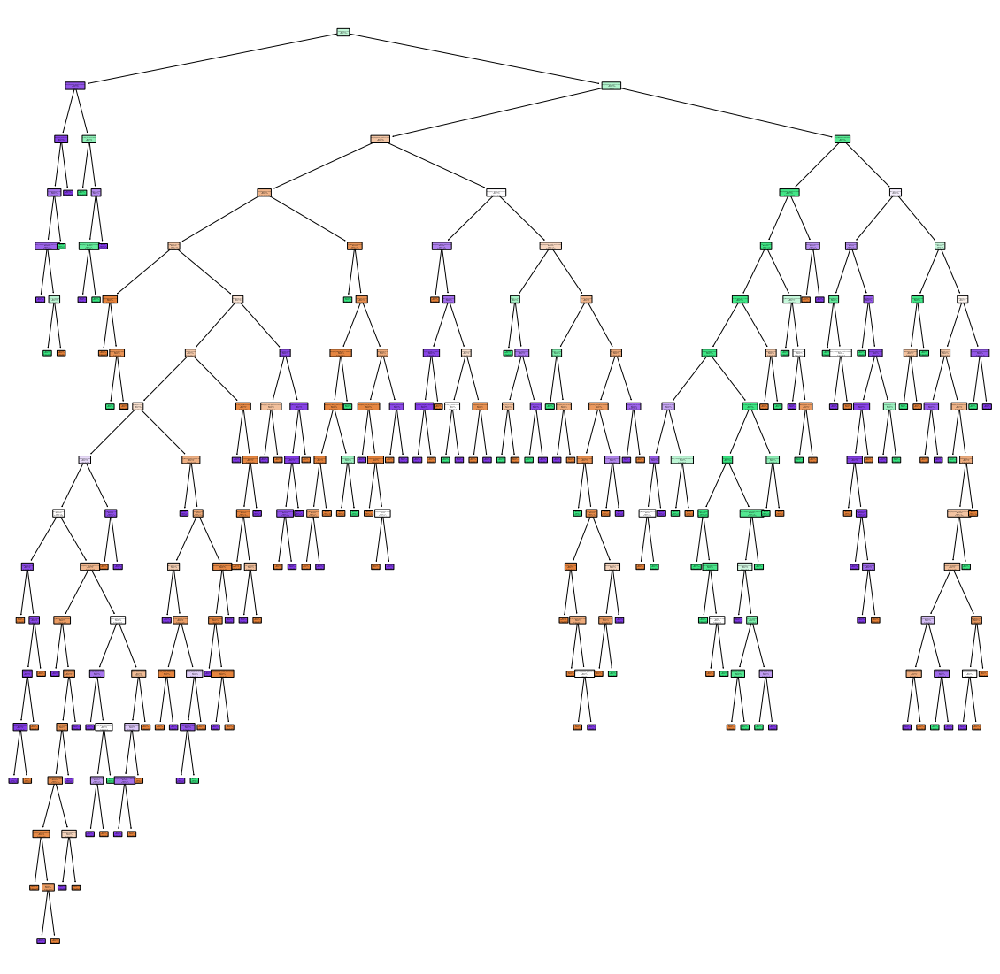

In [320]:
# Find the index of the tree with the highest accuracy on the training data
tree_accuracies = [accuracy_score(y_train, tree.predict(X_train)) for tree in rf.estimators_]
most_accurate_tree_index = tree_accuracies.index(max(tree_accuracies))

most_accurate_tree = rf.estimators_[most_accurate_tree_index]

# Plot the tree
plt.figure(figsize=(20, 20))
plot_tree(most_accurate_tree, filled=True, feature_names=X_train.columns, class_names=[str(i) for i in rf_weight.classes_], rounded=True)
plt.savefig('decision_tree.png', dpi=300)
plt.show()


In [328]:
from sklearn.tree import export_graphviz
import graphviz

In [297]:
analysis_features_df_train = features_df_train.copy()

In [295]:
y_pred = rf.predict(X)


In [298]:
analysis_features_df_train['pred'] = y_pred

In [300]:
analysis_features_df_train

,Card,count_total,count_received,count_given,mean_total,mean_given,mean_received,std_total,std_given,std_received,...,isolation_anomaly_given,isolation_normal_given,isolation_mean_given,isolation_std_given,isolation_anomaly_received,isolation_normal_received,isolation_mean_received,isolation_std_received,label,pred
5595,009e24d27d670b24a73d,1068,694,374,7.305243e+06,5.665634e+06,1.034773e+07,1.079957e+07,9.164714e+06,1.277888e+07,...,1,693,0.140011,0.033638,50,324,0.029615,0.026904,1.0,1
5596,034ae47f44e914cb7ee6,48,46,2,7.927083e+06,7.086957e+06,2.725000e+07,1.665418e+07,1.579145e+07,3.217336e+07,...,0,46,0.141262,0.032714,0,2,0.120964,0.036435,1.0,1
5597,0b2c8a4c5e9a0b1546ee,381,321,60,3.895570e+07,3.695654e+07,4.965117e+07,4.243350e+07,4.228636e+07,4.196013e+07,...,32,289,0.096558,0.068955,1,59,0.074220,0.049342,1.0,1
5598,0cdf22b047d079e06299,520,518,2,6.663904e+06,6.361448e+06,8.500000e+07,1.324461e+07,1.230435e+07,2.121320e+07,...,0,518,0.147074,0.031504,0,2,0.070179,0.014551,1.0,1
5599,0cf173146d0cdb62a209,419,395,24,7.314415e+06,6.834937e+06,1.520583e+07,1.239616e+07,1.205940e+07,1.524785e+07,...,1,394,0.142412,0.029057,0,24,0.127881,0.034370,1.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8825,1b30d7dd0f8cf938d7dc,20,20,0,8.965836e+06,8.965836e+06,0.000000e+00,1.240173e+07,1.240173e+07,0.000000e+00,...,0,20,0.116837,0.034316,0,0,0.000000,0.000000,0.0,0
8826,64e272dfcf2db4b4d4af,10,10,0,7.970000e+06,7.970000e+06,0.000000e+00,1.065771e+07,1.065771e+07,0.000000e+00,...,0,10,0.136283,0.041465,0,0,0.000000,0.000000,0.0,0
8827,77787842a915e581e2b6,10,10,0,7.600000e+06,7.600000e+06,0.000000e+00,8.662820e+06,8.662820e+06,0.000000e+00,...,0,10,0.155044,0.026117,0,0,0.000000,0.000000,0.0,0
8828,c618a52c75a225593871,10,10,0,5.513700e+07,5.513700e+07,0.000000e+00,3.269375e+07,3.269375e+07,0.000000e+00,...,2,8,0.057498,0.047528,0,0,0.000000,0.000000,0.0,0


In [301]:
false = analysis_features_df_train[analysis_features_df_train['label'] != analysis_features_df_train['pred']]

In [305]:
false_0 = false[false['label'] == 0 ]
false_1 = false[false['label'] == 1 ]
false_2 = false[false['label'] == 2 ]

In [333]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [335]:
false_1

,Card,count_total,count_received,count_given,mean_total,mean_given,mean_received,std_total,std_given,std_received,mean_total_minute,mean_given_minute,mean_received_minute,mean_total_hour,mean_given_hour,mean_received_hour,mean_total_hourBin,mean_given_hourBin,mean_received_hourBin,std_combined,std_total_hour,std_given_hour,std_recived_hour,std_total_hour_amt,std_given_hour_amt,std_received_hour_amt,mean_total_day,mean_given_day,mean_recived_day,std_total_day,std_given_day,std_received_day,std_total_day_amt,std_given_day_amt,std_received_day_amt,mean_total_month,mean_given_month,mean_received_month,std_total_month_amt,std_given_month_amt,std_received_month_amt,count_total_termnialType,count_given_termnialType,count_received_termnialType,count_total_termnialID,count_given_termnialID,count_received_termnialID,mean_total_termnialID_count,mean_given_termnialID_count,mean_received_termnialID_count,count_unique_secondID,count_unique_primaryID,count_unique_ID,mean_total_Primary_ID_counts,mean_given_Primary_ID_counts,mean_received_Primary_ID_counts,mean_total_Second_ID_counts_counts,mean_given_Second_ID_counts_counts,mean_received_Second_ID_counts_counts,min_time_day,min_time_hour,max_time_day,max_time_hour,std_time,range_time,type_1,type_5,type_6,type_7,autocorrelation_lag_1,autocorrelation_lag_2,isolation_anomaly_total,isolation_normal_total,isolation_mean_total,isolation_std_total,isolation_anomaly_given,isolation_normal_given,isolation_mean_given,isolation_std_given,isolation_anomaly_received,isolation_normal_received,isolation_mean_received,isolation_std_received,label,pred
5624,3edf59a6b3d7cc98e6d2,26,14,12,1.362000e+07,7.142857e+06,2.117667e+07,1.295361e+07,4.554915e+06,1.552886e+07,25.500000,25.642857,25.333333,9.153846,9.214286,9.083333,3.692308,3.714286,3.666667,1.140138e+09,6.214128,7.127181,5.264950,8.430272e+06,4.242641e+06,5.773503e+06,20.038462,23.000000,16.583333,6.605941,0.000000,8.659817,1.401915e+07,4.554915e+06,1.482911e+07,4.769231,5.000000,4.500000,1.686080e+07,4.554915e+06,1.756677e+07,1,1,1,6,5,1,151543.346154,236297.928571,52663.000000,7,9,16,8.038462,4.642857,12.0,35.807692,14.0,61.250000,5,8,26,9,25.035271,82,1.362000e+07,0.0,0.0,0.000000e+00,0.239033,-0.044737,0,26,0.135488,0.025765,0,14,0.137977,0.027309,0,12,0.132584,0.024703,1.0,2
5646,7be49fdcbee85afd039c,915,443,472,1.385367e+07,1.519131e+07,1.259822e+07,1.605076e+07,2.088569e+07,9.344645e+06,28.063388,27.302483,28.777542,10.316940,10.404063,10.235169,4.099454,4.108352,4.091102,9.899894e+08,6.629957,6.197845,7.016949,1.492525e+07,1.950401e+07,9.018219e+06,14.927869,14.731377,15.112288,8.516764,8.778706,8.268459,1.413736e+07,1.780236e+07,8.085526e+06,3.935519,3.918736,3.951271,1.572826e+07,2.081422e+07,8.311141e+06,2,2,2,78,74,8,84974.084153,107641.297968,63699.559322,317,264,581,256.995628,27.916479,472.0,403.660109,443.0,366.737288,3,3,28,20,24.327864,86,1.204891e+07,0.0,0.0,4.262963e+07,0.166259,0.154847,20,895,0.081477,0.057158,2,441,0.129259,0.043160,18,454,0.036630,0.020709,1.0,2
8638,019674835b762966cb76,27,17,10,2.640741e+07,2.635294e+07,2.650000e+07,1.374006e+07,1.640481e+07,8.181958e+06,27.185185,28.529412,24.900000,10.185185,11.352941,8.200000,4.074074,4.588235,3.200000,1.254760e+09,6.816479,7.623493,4.894441,1.332057e+07,1.414214e+07,5.773503e+06,13.555556,15.176471,10.800000,10.001282,9.824938,10.195860,8.697107e+06,1.191980e+07,3.535534e+06,4.222222,4.235294,4.200000,1.421017e+07,1.755244e+07,7.786154e+06,2,2,2,7,5,3,23719.703704,32318.764706,9101.300000,6,2,8,107.037037,164.117647,10.0,164.074074,17.0,414.100000,8,15,27,6,20.731082,79,2.905882e+07,0.0,0.0,2.190000e+07,0.078166,-0.033907,2,25,0.062022,0.052591,2,15,0.026959,0.024834,0,10,0.121630,0.024971,1.0,2
8780,1036c0ddec8cae76de27,32,24,8,4.294688e+06,2.865833e+06,8.581250e+06,7.026025e+06,3.817342e+06,1.194727e+07,33.531250,35.458333,27.750000,4.937500,4.250000,7.000000,2.406250,2.166667,3.125000,4.185904e+08,2.804806,2.722690,2.000000,4.254498e+06,1.964041e+06,8.804745e+06,12.000000

In [332]:
false_1.loc[5624]

Card                         3edf59a6b3d7cc98e6d2
count_total                                    26
count_received                                 14
count_given                                    12
mean_total                             13620000.0
                                     ...         
isolation_normal_received                      12
isolation_mean_received                  0.132584
isolation_std_received                   0.024703
label                                         1.0
pred                                            2
Name: 5624, Length: 85, dtype: object

In [337]:
false_2.columns

Index(['Card', 'count_total', 'count_received', 'count_given', 'mean_total',
       'mean_given', 'mean_received', 'std_total', 'std_given', 'std_received',
       'mean_total_minute', 'mean_given_minute', 'mean_received_minute',
       'mean_total_hour', 'mean_given_hour', 'mean_received_hour',
       'mean_total_hourBin', 'mean_given_hourBin', 'mean_received_hourBin',
       'std_combined', 'std_total_hour', 'std_given_hour', 'std_recived_hour',
       'std_total_hour_amt', 'std_given_hour_amt', 'std_received_hour_amt',
       'mean_total_day', 'mean_given_day', 'mean_recived_day', 'std_total_day',
       'std_given_day', 'std_received_day', 'std_total_day_amt',
       'std_given_day_amt', 'std_received_day_amt', 'mean_total_month',
       'mean_given_month', 'mean_received_month', 'std_total_month_amt',
       'std_given_month_amt', 'std_received_month_amt',
       'count_total_termnialType', 'count_given_termnialType',
       'count_received_termnialType', 'count_total_termnialID',

In [313]:
y_test.value_counts() / len(y_test)

1    0.537618
2    0.257053
0    0.205329
Name: label, dtype: float64

In [315]:
class_weights = {0: 0.205329, 1: 0.537618, 2:0.257053}
rf_weight = RandomForestClassifier(n_estimators=500, random_state=42, class_weight=class_weights)
rf_weight.fit(X_train, y_train)
y_pred = rf_weight.predict(X_test)
y_prob = rf_weight.predict_proba(X_test)[:, 1]
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average=None)
print('accuracy : ' ,accuracy)
print("Classification Report:\n", classification_report(y_test, y_pred))

accuracy :  0.9388714733542319
Classification Report:
               precision    recall  f1-score   support

           0       0.87      0.88      0.87       131
           1       0.98      0.99      0.99       343
           2       0.90      0.88      0.89       164

    accuracy                           0.94       638
   macro avg       0.92      0.92      0.92       638
weighted avg       0.94      0.94      0.94       638



In [219]:
from xgboost import XGBClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.neural_network import MLPClassifier
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.metrics import accuracy_score, f1_score, classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_classification

# Generate sample data

In [ ]:
0.9404

In [227]:
clf = XGBClassifier(n_estimators=1000, random_state=42)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
y_prob = clf.predict_proba(X_test)[:, 1]
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average=None)
print('accuracy:', accuracy)
print("Classification Report:\n", classification_report(y_test, y_pred))

accuracy: 0.9404388714733543
Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.84      0.86       131
           1       0.98      1.00      0.99       343
           2       0.90      0.90      0.90       164

    accuracy                           0.94       638
   macro avg       0.92      0.91      0.92       638
weighted avg       0.94      0.94      0.94       638



In [ ]:
.935

In [226]:
clf = GradientBoostingClassifier(n_estimators=500, random_state=42)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
y_prob = clf.predict_proba(X_test)[:, 1]
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average=None)
print('accuracy:', accuracy)
print("Classification Report:\n", classification_report(y_test, y_pred))

accuracy: 0.9357366771159875
Classification Report:
               precision    recall  f1-score   support

           0       0.87      0.85      0.86       131
           1       0.99      0.99      0.99       343
           2       0.88      0.89      0.88       164

    accuracy                           0.94       638
   macro avg       0.91      0.91      0.91       638
weighted avg       0.94      0.94      0.94       638



In [225]:
clf = ExtraTreesClassifier(n_estimators=500, random_state=42)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
y_prob = clf.predict_proba(X_test)[:, 1]
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average=None)
print('accuracy:', accuracy)
print("Classification Report:\n", classification_report(y_test, y_pred))

accuracy: 0.9341692789968652
Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.87      0.88       131
           1       0.99      0.97      0.98       343
           2       0.86      0.91      0.88       164

    accuracy                           0.93       638
   macro avg       0.91      0.92      0.91       638
weighted avg       0.94      0.93      0.93       638



In [224]:
clf = AdaBoostClassifier(n_estimators=500, random_state=42)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
y_prob = clf.predict_proba(X_test)[:, 1]
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average=None)
print('accuracy:', accuracy)
print("Classification Report:\n", classification_report(y_test, y_pred))

accuracy: 0.9059561128526645
Classification Report:
               precision    recall  f1-score   support

           0       0.77      0.85      0.80       131
           1       0.99      0.98      0.99       343
           2       0.86      0.79      0.82       164

    accuracy                           0.91       638
   macro avg       0.87      0.87      0.87       638
weighted avg       0.91      0.91      0.91       638



In [223]:
clf = MLPClassifier(hidden_layer_sizes=(1000,), max_iter=500, random_state=42)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
y_prob = clf.predict_proba(X_test)[:, 1]
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average=None)
print('accuracy:', accuracy)
print("Classification Report:\n", classification_report(y_test, y_pred))

accuracy: 0.9169278996865203
Classification Report:
               precision    recall  f1-score   support

           0       0.86      0.84      0.85       131
           1       0.97      0.97      0.97       343
           2       0.86      0.87      0.86       164

    accuracy                           0.92       638
   macro avg       0.90      0.89      0.89       638
weighted avg       0.92      0.92      0.92       638



In [252]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Perform PCA
n_components = 45  
pca = PCA(n_components=n_components)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# Define the MLP model
model = Sequential()
model.add(Dense(units=128, activation='relu', input_dim=X_train.shape[1]))
model.add(Dropout(0.5))
model.add(Dense(units=64, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(units=32, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(units=3, activation='softmax'))

# Compile the model
model.compile(optimizer=Adam(lr=0.0001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
# Train the model
model.fit(X_train_scaled, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
# Predictions
y_pred_probs = model.predict(X_test_scaled)
y_pred = tf.argmax(y_pred_probs, axis=1)
# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
classification_rep = classification_report(y_test, y_pred)
print('accuracy:', accuracy)
print('f1:', f1)
print("Classification Report:\n", classification_rep)

Epoch 1/100
80/80 [==============================] - 1s 7ms/step - loss: 1.3936 - accuracy: 0.3973 - val_loss: 21998090.0000 - val_accuracy: 0.5376
Epoch 2/100
80/80 [==============================] - 0s 4ms/step - loss: 1.2952 - accuracy: 0.4114 - val_loss: 16283860.0000 - val_accuracy: 0.5376
Epoch 3/100
80/80 [==============================] - 0s 4ms/step - loss: 1.2808 - accuracy: 0.4251 - val_loss: 13499321.0000 - val_accuracy: 0.5266
Epoch 4/100
80/80 [==============================] - 0s 4ms/step - loss: 1.1868 - accuracy: 0.4498 - val_loss: 10755381.0000 - val_accuracy: 0.5172
Epoch 5/100
80/80 [==============================] - 0s 4ms/step - loss: 1.1630 - accuracy: 0.4537 - val_loss: 9176104.0000 - val_accuracy: 0.3072
Epoch 6/100
80/80 [==============================] - 0s 4ms/step - loss: 1.1435 - accuracy: 0.4588 - val_loss: 10372634.0000 - val_accuracy: 0.2382
Epoch 7/100
80/80 [==============================] - 0s 4ms/step - loss: 1.0934 - accuracy: 0.4820 - val_loss: 13

Epoch 56/100
80/80 [==============================] - 0s 5ms/step - loss: 0.5248 - accuracy: 0.7957 - val_loss: 174445792.0000 - val_accuracy: 0.2194
Epoch 57/100
80/80 [==============================] - 0s 5ms/step - loss: 0.5283 - accuracy: 0.7855 - val_loss: 177828784.0000 - val_accuracy: 0.2194
Epoch 58/100
80/80 [==============================] - 0s 6ms/step - loss: 0.5241 - accuracy: 0.7973 - val_loss: 184963008.0000 - val_accuracy: 0.2194
Epoch 59/100
80/80 [==============================] - 0s 5ms/step - loss: 0.5137 - accuracy: 0.7953 - val_loss: 192748624.0000 - val_accuracy: 0.2194
Epoch 60/100
80/80 [==============================] - 0s 4ms/step - loss: 0.5053 - accuracy: 0.7941 - val_loss: 198742768.0000 - val_accuracy: 0.2194
Epoch 61/100
80/80 [==============================] - 0s 6ms/step - loss: 0.5196 - accuracy: 0.8031 - val_loss: 202206960.0000 - val_accuracy: 0.2194
Epoch 62/100
80/80 [==============================] - 0s 6ms/step - loss: 0.5267 - accuracy: 0.7906 

In [236]:


#Define the MLP model
model = Sequential()
model.add(Dense(units=128, activation='relu', input_dim=X_train.shape[1]))
model.add(BatchNormalization())
model.add(Dense(units=64, activation='relu'))
model.add(BatchNormalization())
model.add(Dense(units=32, activation='relu'))
model.add(BatchNormalization())
model.add(Dense(units=3, activation='softmax'))


# Compile the model
model.compile(optimizer=Adam(lr=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
# Train the model
model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
# Predictions
y_pred_probs = model.predict(X_test)
y_pred = tf.argmax(y_pred_probs, axis=1)
# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
classification_rep = classification_report(y_test, y_pred)
print('accuracy:', accuracy)
print('f1:', f1)
print("Classification Report:\n", classification_rep)

Epoch 1/100
80/80 [==============================] - 2s 7ms/step - loss: 0.7540 - accuracy: 0.6890 - val_loss: 0.6183 - val_accuracy: 0.8103
Epoch 2/100
80/80 [==============================] - 0s 4ms/step - loss: 0.3888 - accuracy: 0.8573 - val_loss: 0.3832 - val_accuracy: 0.8824
Epoch 3/100
80/80 [==============================] - 0s 4ms/step - loss: 0.2998 - accuracy: 0.8894 - val_loss: 0.3072 - val_accuracy: 0.9044
Epoch 4/100
80/80 [==============================] - 0s 4ms/step - loss: 0.2531 - accuracy: 0.9137 - val_loss: 0.2873 - val_accuracy: 0.9044
Epoch 5/100
80/80 [==============================] - 0s 4ms/step - loss: 0.2114 - accuracy: 0.9231 - val_loss: 0.2809 - val_accuracy: 0.9154
Epoch 6/100
80/80 [==============================] - 0s 4ms/step - loss: 0.1954 - accuracy: 0.9267 - val_loss: 0.2954 - val_accuracy: 0.9060
Epoch 7/100
80/80 [==============================] - 0s 4ms/step - loss: 0.1828 - accuracy: 0.9286 - val_loss: 0.3456 - val_accuracy: 0.9028
Epoch 8/100
8

Epoch 59/100
80/80 [==============================] - 0s 5ms/step - loss: 0.0505 - accuracy: 0.9820 - val_loss: 0.5300 - val_accuracy: 0.9122
Epoch 60/100
80/80 [==============================] - 0s 5ms/step - loss: 0.0415 - accuracy: 0.9863 - val_loss: 0.4901 - val_accuracy: 0.9201
Epoch 61/100
80/80 [==============================] - 0s 4ms/step - loss: 0.0219 - accuracy: 0.9922 - val_loss: 0.5493 - val_accuracy: 0.9154
Epoch 62/100
80/80 [==============================] - 0s 3ms/step - loss: 0.0278 - accuracy: 0.9906 - val_loss: 0.5029 - val_accuracy: 0.9138
Epoch 63/100
80/80 [==============================] - 0s 4ms/step - loss: 0.0358 - accuracy: 0.9867 - val_loss: 0.5903 - val_accuracy: 0.9091
Epoch 64/100
80/80 [==============================] - 0s 3ms/step - loss: 0.0276 - accuracy: 0.9890 - val_loss: 0.5303 - val_accuracy: 0.9122
Epoch 65/100
80/80 [==============================] - 0s 4ms/step - loss: 0.0274 - accuracy: 0.9902 - val_loss: 0.5691 - val_accuracy: 0.9013
Epoch 

In [237]:
X_train

array([[ 0.06278698,  0.06681867, -0.25761217, ..., -0.25888987,
        -0.81447481, -0.65230958],
       [-0.21974782, -0.22495561,  0.33283175, ...,  0.3616532 ,
         0.42099871,  0.74816787],
       [-0.06527786, -0.06124516, -0.25761217, ..., -0.25888987,
        -0.81447481, -0.65230958],
       ...,
       [-0.22766936, -0.2275961 , -0.00456478, ...,  0.00705716,
         0.48233841,  1.13656329],
       [-0.12666977, -0.12527707, -0.08891391, ..., -0.08159185,
         0.32329152,  1.49389587],
       [-0.22304846, -0.21901451, -0.25761217, ..., -0.25888987,
        -0.81447481, -0.65230958]])